Enter Keyboard Layout qwerty
Enter the text to be analyzed Hi my name is Prajwal Vijay. I am 19 years old. I am a sophomore student studying in the Department of Electrical Engineering at IIT Madras. The following is a demo of my Applied programming lab (EE2703) assignment 4, where I have created and analysed various layouts of keyboards in python using matplotlib.


Animation size has reached 20986186 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Distance Travelled 357.4539533368715


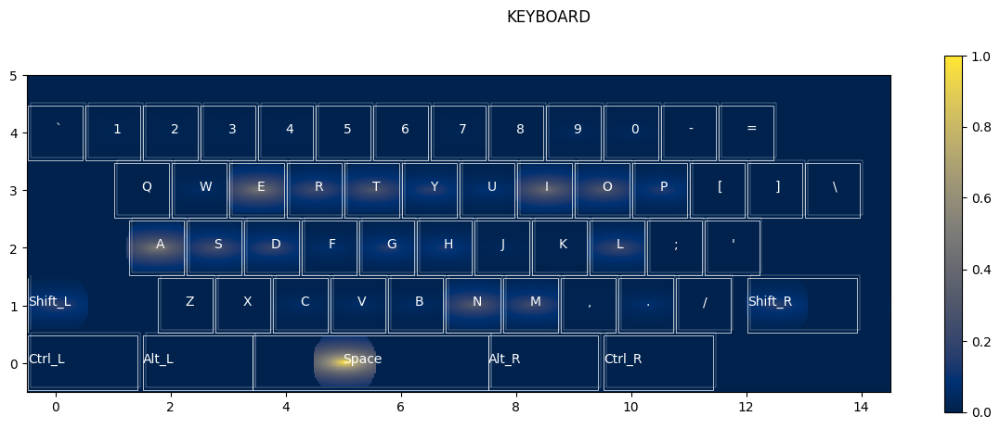

In [17]:
#Importing the required libraries
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import math
from matplotlib import animation
from IPython import display 
keys={}
distance_travelled = 0
layout = input("Enter Keyboard Layout")

# The dictionary of all possible characters in the input string
characters = {
    # Lowercase letters (unchanged)
    'a': ('a',), 'b': ('b',), 'c': ('c',), 'd': ('d',), 'e': ('e',),
    'f': ('f',), 'g': ('g',), 'h': ('h',), 'i': ('i',), 'j': ('j',),
    'k': ('k',), 'l': ('l',), 'm': ('m',), 'n': ('n',), 'o': ('o',),
    'p': ('p',), 'q': ('q',), 'r': ('r',), 's': ('s',), 't': ('t',),
    'u': ('u',), 'v': ('v',), 'w': ('w',), 'x': ('x',), 'y': ('y',),
    'z': ('z',),
    
    # Uppercase letters (updated)
    'A': ('Shift_R', 'a'), 'B': ('Shift_R', 'b'), 'C': ('Shift_R', 'c'),
    'D': ('Shift_R', 'd'), 'E': ('Shift_R', 'e'), 'F': ('Shift_R', 'f'),
    'G': ('Shift_R', 'g'), 'H': ('Shift_L', 'h'), 'I': ('Shift_L', 'i'),
    'J': ('Shift_L', 'j'), 'K': ('Shift_L', 'k'), 'L': ('Shift_L', 'l'),
    'M': ('Shift_L', 'm'), 'N': ('Shift_L', 'n'), 'O': ('Shift_L', 'o'),
    'P': ('Shift_L', 'p'), 'Q': ('Shift_R', 'q'), 'R': ('Shift_R', 'r'),
    'S': ('Shift_R', 's'), 'T': ('Shift_R', 't'), 'U': ('Shift_L', 'u'),
    'V': ('Shift_R', 'v'), 'W': ('Shift_R', 'w'), 'X': ('Shift_R', 'x'),
    'Y': ('Shift_L', 'y'), 'Z': ('Shift_R', 'z'),
    
    # Numbers and their shifted symbols (updated)
    '1': ('1',), '!': ('Shift_R', '1'),
    '2': ('2',), '@': ('Shift_R', '2'),
    '3': ('3',), '#': ('Shift_R', '3'),
    '4': ('4',), '$': ('Shift_R', '4'),
    '5': ('5',), '%': ('Shift_R', '5'),
    '6': ('6',), '^': ('Shift_L', '6'),
    '7': ('7',), '&': ('Shift_L', '7'),
    '8': ('8',), '*': ('Shift_L', '8'),
    '9': ('9',), '(': ('Shift_L', '9'),
    '0': ('0',), ')': ('Shift_L', '0'),
    
    # Other symbols (updated)
    '`': ('`',), '~': ('Shift_R', '`'),
    '-': ('-',), '_': ('Shift_L', '-'),
    '=': ('=',), '+': ('Shift_L', '='),
    '[': ('[',), '{': ('Shift_L', '['),
    ']': (']',), '}': ('Shift_L', ']'),
    '\\': ('\\',), '|': ('Shift_L', '\\'),
    ';': (';',), ':': ('Shift_L', ';'),
    "'": ("'",), '"': ('Shift_L', "'"),
    ',': (',',), '<': ('Shift_L', ','),
    '.': ('.',), '>': ('Shift_L', '.'),
    '/': ('/',), '?': ('Shift_L', '/'),
    
    # Space (unchanged)
    ' ': ('Space',),
}

# QWERTY Layout
QWERTY_LAYOUT = {
    # Number row
    '`': {'pos': (0, 4), 'start': 'a'},
    '1': {'pos': (1, 4), 'start': 'a'},
    '2': {'pos': (2, 4), 'start': 'a'},
    '3': {'pos': (3, 4), 'start': 's'},
    '4': {'pos': (4, 4), 'start': 'd'},
    '5': {'pos': (5, 4), 'start': 'f'},
    '6': {'pos': (6, 4), 'start': 'j'},
    '7': {'pos': (7, 4), 'start': 'j'},
    '8': {'pos': (8, 4), 'start': 'k'},
    '9': {'pos': (9, 4), 'start': 'l'},
    '0': {'pos': (10, 4), 'start': ';'},
    '-': {'pos': (11, 4), 'start': ';'},
    '=': {'pos': (12, 4), 'start': ';'},
    
    # Top letter row
    'q': {'pos': (1.5, 3), 'start': 'a'},
    'w': {'pos': (2.5, 3), 'start': 's'},
    'e': {'pos': (3.5, 3), 'start': 'd'},
    'r': {'pos': (4.5, 3), 'start': 'f'},
    't': {'pos': (5.5, 3), 'start': 'f'},
    'y': {'pos': (6.5, 3), 'start': 'j'},
    'u': {'pos': (7.5, 3), 'start': 'j'},
    'i': {'pos': (8.5, 3), 'start': 'k'},
    'o': {'pos': (9.5, 3), 'start': 'l'},
    'p': {'pos': (10.5, 3), 'start': ';'},
    '[': {'pos': (11.5, 3), 'start': ';'},
    ']': {'pos': (12.5, 3), 'start': ';'},
    '\\': {'pos': (13.5, 3), 'start': ';'},
    
    # Home row
    'a': {'pos': (1.75, 2), 'start': 'a'},
    's': {'pos': (2.75, 2), 'start': 's'},
    'd': {'pos': (3.75, 2), 'start': 'd'},
    'f': {'pos': (4.75, 2), 'start': 'f'},
    'g': {'pos': (5.75, 2), 'start': 'f'},
    'h': {'pos': (6.75, 2), 'start': 'j'},
    'j': {'pos': (7.75, 2), 'start': 'j'},
    'k': {'pos': (8.75, 2), 'start': 'k'},
    'l': {'pos': (9.75, 2), 'start': 'l'},
    ';': {'pos': (10.75, 2), 'start': ';'},
    "'": {'pos': (11.75, 2), 'start': ';'},
    
    # Bottom letter row
    'z': {'pos': (2.25, 1), 'start': 'a'},
    'x': {'pos': (3.25, 1), 'start': 's'},
    'c': {'pos': (4.25, 1), 'start': 'd'},
    'v': {'pos': (5.25, 1), 'start': 'f'},
    'b': {'pos': (6.25, 1), 'start': 'f'},
    'n': {'pos': (7.25, 1), 'start': 'j'},
    'm': {'pos': (8.25, 1), 'start': 'j'},
    ',': {'pos': (9.25, 1), 'start': 'k'},
    '.': {'pos': (10.25, 1), 'start': 'l'},
    '/': {'pos': (11.25, 1), 'start': ';'},
    
    # Special keys
    'Shift_L': {'pos': (0, 1), 'start': 'a'},
    'Shift_R': {'pos': (12.5, 1), 'start': ';'},
    'Ctrl_L': {'pos': (0, 0), 'start': 'a'},
    'Alt_L': {'pos': (2, 0), 'start': 'a'},
    'Space': {'pos': (5, 0), 'start': 'f'},
    'Alt_R': {'pos': (8, 0), 'start': 'j'},
    'Ctrl_R': {'pos': (10, 0), 'start': ';'},
}

#DVORAK LAYOUT
DVORAK_LAYOUT = {

    # Number row
    '`': {'pos': (0, 4), 'start': 'a'},
    '1': {'pos': (1, 4), 'start': 'a'},
    '2': {'pos': (2, 4), 'start': 'a'},
    '3': {'pos': (3, 4), 'start': 'o'},
    '4': {'pos': (4, 4), 'start': 'e'},
    '5': {'pos': (5, 4), 'start': 'u'},
    '6': {'pos': (6, 4), 'start': 'h'},
    '7': {'pos': (7, 4), 'start': 'h'},
    '8': {'pos': (8, 4), 'start': 't'},
    '9': {'pos': (9, 4), 'start': 'n'},
    '0': {'pos': (10, 4), 'start': 's'},
    '[': {'pos': (11, 4), 'start': 's'},
    ']': {'pos': (12, 4), 'start': 's'},
    
    # Top letter row
    '\'': {'pos': (1.5, 3), 'start': 'a'},
    ',': {'pos': (2.5, 3), 'start': 'o'},
    '.': {'pos': (3.5, 3), 'start': 'e'},
    'p': {'pos': (4.5, 3), 'start': 'u'},
    'y': {'pos': (5.5, 3), 'start': 'u'},
    'f': {'pos': (6.5, 3), 'start': 'h'},
    'g': {'pos': (7.5, 3), 'start': 'h'},
    'c': {'pos': (8.5, 3), 'start': 't'},
    'r': {'pos': (9.5, 3), 'start': 'n'},
    'l': {'pos': (10.5, 3), 'start': 's'},
    '/': {'pos': (11.5, 3), 'start': 's'},
    '=': {'pos': (12.5, 3), 'start': 's'},
    '\\': {'pos': (13.5, 3), 'start': 's'},
    
    # Home row
    'a': {'pos': (1.75, 2), 'start': 'a'},
    'o': {'pos': (2.75, 2), 'start': 'o'},
    'e': {'pos': (3.75, 2), 'start': 'e'},
    'u': {'pos': (4.75, 2), 'start': 'u'},
    'i': {'pos': (5.75, 2), 'start': 'u'},
    'd': {'pos': (6.75, 2), 'start': 'h'},
    'h': {'pos': (7.75, 2), 'start': 'h'},
    't': {'pos': (8.75, 2), 'start': 't'},
    'n': {'pos': (9.75, 2), 'start': 'n'},
    's': {'pos': (10.75, 2), 'start': 's'},
    "'": {'pos': (11.75, 2), 'start': 's'},
    
    # Bottom letter row
    ';': {'pos': (2.25, 1), 'start': 'a'},
    'q': {'pos': (3.25, 1), 'start': 'o'},
    'j': {'pos': (4.25, 1), 'start': 'e'},
    'k': {'pos': (5.25, 1), 'start': 'u'},
    'x': {'pos': (6.25, 1), 'start': 'u'},
    'b': {'pos': (7.25, 1), 'start': 'h'},
    'm': {'pos': (8.25, 1), 'start': 'h'},
    'w': {'pos': (9.25, 1), 'start': 't'},
    'v': {'pos': (10.25, 1), 'start': 'n'},
    'z': {'pos': (11.25, 1), 'start': 's'},
    
    # Special keys
    'Shift_L': {'pos': (0, 1), 'start': 'a'},
    'Shift_R': {'pos': (12.5, 1), 'start': 's'},
    'Ctrl_L': {'pos': (0, 0), 'start': 'a'},
    'Alt_L': {'pos': (2, 0), 'start': 'a'},
    'Space': {'pos': (5, 0), 'start': 'u'},
    'Alt_R': {'pos': (8, 0), 'start': 'n'},
    'Ctrl_R': {'pos': (10, 0), 'start': 's'}, 
}

# COLEMAK LAYOUT
COLEMAK_LAYOUT = {
    # Number row
    '`': {'pos': (0, 4), 'start': 'a'},
    '1': {'pos': (1, 4), 'start': 'a'},
    '2': {'pos': (2, 4), 'start': 'a'},
    '3': {'pos': (3, 4), 'start': 'r'},
    '4': {'pos': (4, 4), 'start': 's'},
    '5': {'pos': (5, 4), 'start': 't'},
    '6': {'pos': (6, 4), 'start': 'n'},
    '7': {'pos': (7, 4), 'start': 'n'},
    '8': {'pos': (8, 4), 'start': 'e'},
    '9': {'pos': (9, 4), 'start': 'i'},
    '0': {'pos': (10, 4), 'start': 'o'},
    '-': {'pos': (11, 4), 'start': 'o'},
    '=': {'pos': (12, 4), 'start': 'o'},

    # Top letter row
    'q': {'pos': (1.5, 3), 'start': 'a'},
    'w': {'pos': (2.5, 3), 'start': 'r'},
    'f': {'pos': (3.5, 3), 'start': 's'},
    'p': {'pos': (4.5, 3), 'start': 't'},
    'g': {'pos': (5.5, 3), 'start': 't'},
    'j': {'pos': (6.5, 3), 'start': 'n'},
    'l': {'pos': (7.5, 3), 'start': 'n'},
    'u': {'pos': (8.5, 3), 'start': 'e'},
    'y': {'pos': (9.5, 3), 'start': 'i'},
    ';': {'pos': (10.5, 3), 'start': 'o'},
    '[': {'pos': (11.5, 3), 'start': 'o'},
    ']': {'pos': (12.5, 3), 'start': 'o'},
    '\\': {'pos': (13.5, 3), 'start': 'o'},
    
    # Home row
    'a': {'pos': (1.75, 2), 'start': 'a'},
    'r': {'pos': (2.75, 2), 'start': 'r'},
    's': {'pos': (3.75, 2), 'start': 's'},
    't': {'pos': (4.75, 2), 'start': 't'},
    'd': {'pos': (5.75, 2), 'start': 't'},
    'h': {'pos': (6.75, 2), 'start': 'n'},
    'n': {'pos': (7.75, 2), 'start': 'n'},
    'e': {'pos': (8.75, 2), 'start': 'e'},
    'i': {'pos': (9.75, 2), 'start': 'i'},
    'o': {'pos': (10.75, 2), 'start': 'o'},
    "'": {'pos': (11.75, 2), 'start': 'o'},
    
    # Bottom letter row
    'z': {'pos': (2.25, 1), 'start': 'a'},
    'x': {'pos': (3.25, 1), 'start': 'r'},
    'c': {'pos': (4.25, 1), 'start': 's'},
    'v': {'pos': (5.25, 1), 'start': 't'},
    'b': {'pos': (6.25, 1), 'start': 't'},
    'k': {'pos': (7.25, 1), 'start': 'n'},
    'm': {'pos': (8.25, 1), 'start': 'n'},
    '.': {'pos': (9.25, 1), 'start': 'e'},
    ',': {'pos': (10.25, 1), 'start': 'i'},
    '/': {'pos': (11.25, 1), 'start': 'o'},
    
    # Special keys
    'Shift_L': {'pos': (0, 1), 'start': 'a'},
    'Shift_R': {'pos': (12.5, 1), 'start': 'o'},
    'Ctrl_L': {'pos': (0, 0), 'start': 'a'},
    'Alt_L': {'pos': (2, 0), 'start': 'a'},
    'Space': {'pos': (5, 0), 'start': 't'},
    'Alt_R': {'pos': (8, 0), 'start': 'n'},
    'Ctrl_R': {'pos': (10, 0), 'start': 'o'},
}

# Conditions on which layout to choose
if layout.lower() == 'qwerty':
    layout = QWERTY_LAYOUT
elif layout.lower() == 'dvorak':
    layout = DVORAK_LAYOUT
elif layout.lower() == 'colemak':
    layout = COLEMAK_LAYOUT
else:
    # In case none of the above specified layouts are given
    layout = eval(input("Enter layout"))
    
# Function to get key position
def get_key_position(key):
    return layout[key]['pos']

# Defining the plot
figsize = (15,5)
fig = plt.figure(1,figsize=figsize)
plt.suptitle("KEYBOARD")
ax = plt.gca()
ax.set_xlim([-0.5, figsize[0]-0.5])
ax.set_ylim([-0.5, figsize[1]])
limits = {}
size = 0.95
text=""

# Asking for input text to be analysed
text = input("Enter the text to be analyzed")
limits = {}

# Plotting the heatmap 
im = plt.imshow(np.zeros((1,1), float) , cmap = 'cividis' , interpolation = 'nearest' , origin='lower',
           aspect='equal',  extent = [-0.5, figsize[0]-0.5, -0.5, figsize[1]], vmin=0, vmax=1)
plt.colorbar()

# Creating a new keyboard, using the layout specified above
def create_keyboard():
    global keys
    global layout
    lower_lim = +math.inf
    upper_lim = -math.inf
    for key in layout:
        if len(key) == 1:        
            position = get_key_position(key)
            keys[key] = [position,0] # The first value is the position, while the second corresponds to the number of key presses.
            if position[0]-size/2 < lower_lim and position[1] not in limits:
                lower_lim = position[0]-size/2
            if position[0]+size/2 > upper_lim and position[1] not in limits:
                upper_lim = position[0]+size/2
            limits[position[1]] = (lower_lim, upper_lim)
            ax.add_patch(Rectangle((position[0]-size/2,position[1]-size/2),size,size, facecolor='none', edgecolor='white', linewidth=0.5))
            ax.add_patch(Rectangle((position[0]+0.05*size-size/2,position[1]+0.05*size-size/2),size,size, facecolor='none', edgecolor='white', linewidth=0.2))
            ax.text(position[0], position[1], key.upper(), color='white')
        else:
            position = get_key_position(key)
            keys[key] = [position, 0]
            if key == 'Space':
                locs = sorted([a['pos'][0] for a in layout.values() if a['pos'][1] == position[1]])
                idx = locs.index(position[0])
                ax.add_patch(Rectangle((locs[idx-1]+1.5*size, position[1]-0.5*size), locs[idx+1]-size - (locs[idx-1]+size), size, facecolor='none', edgecolor='white', linewidth=0.5))
                ax.add_patch(Rectangle((locs[idx-1]+1.5*size+0.05*size,position[1]+0.05*size-0.5*size),locs[idx+1]-size - (locs[idx-1]+size), size, facecolor='none', edgecolor='white', linewidth=0.2))
                ax.text(position[0], position[1], key, color='white')
            
            else:
                if position[1] in limits.keys() and limits[position[1]][0] < position[0]+1.5*size < limits[position[1]][1]: # The case when a size of 2 is too large for the given configuration
                    ax.add_patch(Rectangle((position[0]-size/2, position[1]-size/2), limits[position[1]][0]-position[0]+0.5*size, size, facecolor='none', edgecolor='white', linewidth=0.5))
                    ax.add_patch(Rectangle((position[0]-size/2+0.05*size, position[1]-size/2+0.05*size), limits[position[1]][0]-position[0]+0.5*size, size, facecolor='none', edgecolor='white', linewidth=0.2))
                    ax.text(position[0]-0.5*size, position[1], key, color='white')
                else:
                    ax.add_patch(Rectangle((position[0]-size/2,position[1]-size/2), 2*size, size, facecolor='none', edgecolor='white', linewidth=0.5))
                    ax.add_patch(Rectangle((position[0]-size/2+0.05*size,position[1]+0.05*size-size/2), 2*size, size, facecolor='none', edgecolor='white', linewidth=0.2))
                    ax.text(position[0]-0.5*size, position[1], key, color='white')

    # Intializing the heatmap with all null values
    global im
    im.set_data(np.zeros((1,1),float))
    return [im]

# The update function, that takes in the frame number and each frame corresponds to a particular character in the text
def analysis(frame):
    global distance_travelled
    if frame == 0:
        distance_travelled = 0
    global text
    global im
    global keys
    global characters
    global layout
    l = text[int(frame)]
    t = characters[l]

    # Using the characters array to calculate distance travelled
    for key in t:
        pos = get_key_position(key)
        start_key = layout[key]['start']
        start_key_pos = get_key_position(start_key)
        distance_travelled += math.sqrt((start_key_pos[0]-pos[0])**2 + (start_key_pos[1]-pos[1])**2)
        keys[key][1] += 1

    
    x = [d[0][0] for d in keys.values()]
    y = [d[0][1] for d in keys.values()]
    z = [d[1] for d in keys.values()]

    xi = np.linspace(-0.5, figsize[0]-0.5, 10*len(x))
    yi = np.linspace(-0.5, figsize[1], 10*len(y))
    zi = np.zeros((10*len(x), 10*len(y)))
    z = z/np.max(z)

    # Applying a gaussian type of smoothening to the heatmap, so that as the points move away from the heatmap, their intensity reduces.
    for i in range(len(keys)):
        x_idx = np.searchsorted(xi, x[i]) # Finds the index in xi where an element must be inserted inorder to maintain the order.
        y_idx = np.searchsorted(yi, y[i])
        for k in range(-40, 44):
            for j in range(-20, 22):
                if (figsize[1]/figsize[0])**2*abs(k)**2+abs(j)**2 < 400 and y_idx+k < 10*len(x) and x_idx+j < 10*len(y): # To create a circle, given keyboard is NOT a square, so
                    zi[y_idx+k][x_idx+j] = z[i]*math.exp(-math.sqrt(abs(k)**2+abs(j)**2)/math.sqrt(400*size))
    im.set_data(zi)
    if frame == len(text)-1:
        print("Distance Travelled", distance_travelled)
    
    return [im]
# This is the animation function, that performs the required animation
anim = animation.FuncAnimation(fig, analysis, init_func=create_keyboard,
                               frames=np.linspace(0, len(text)-1, len(text)), interval=50, blit=False)
# Displays the keyboard
from IPython.display import HTML
HTML(anim.to_jshtml())

In [ ]:
#Importing the required libraries
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import math
keys={}
distance_travelled = 0
layout = input("Enter Keyboard Layout")

# The dictionary of all possible characters in the input string
characters = {
    # Lowercase letters (unchanged)
    'a': ('a',), 'b': ('b',), 'c': ('c',), 'd': ('d',), 'e': ('e',),
    'f': ('f',), 'g': ('g',), 'h': ('h',), 'i': ('i',), 'j': ('j',),
    'k': ('k',), 'l': ('l',), 'm': ('m',), 'n': ('n',), 'o': ('o',),
    'p': ('p',), 'q': ('q',), 'r': ('r',), 's': ('s',), 't': ('t',),
    'u': ('u',), 'v': ('v',), 'w': ('w',), 'x': ('x',), 'y': ('y',),
    'z': ('z',),
    
    # Uppercase letters (updated)
    'A': ('Shift_R', 'a'), 'B': ('Shift_R', 'b'), 'C': ('Shift_R', 'c'),
    'D': ('Shift_R', 'd'), 'E': ('Shift_R', 'e'), 'F': ('Shift_R', 'f'),
    'G': ('Shift_R', 'g'), 'H': ('Shift_L', 'h'), 'I': ('Shift_L', 'i'),
    'J': ('Shift_L', 'j'), 'K': ('Shift_L', 'k'), 'L': ('Shift_L', 'l'),
    'M': ('Shift_L', 'm'), 'N': ('Shift_L', 'n'), 'O': ('Shift_L', 'o'),
    'P': ('Shift_L', 'p'), 'Q': ('Shift_R', 'q'), 'R': ('Shift_R', 'r'),
    'S': ('Shift_R', 's'), 'T': ('Shift_R', 't'), 'U': ('Shift_L', 'u'),
    'V': ('Shift_R', 'v'), 'W': ('Shift_R', 'w'), 'X': ('Shift_R', 'x'),
    'Y': ('Shift_L', 'y'), 'Z': ('Shift_R', 'z'),
    
    # Numbers and their shifted symbols (updated)
    '1': ('1',), '!': ('Shift_R', '1'),
    '2': ('2',), '@': ('Shift_R', '2'),
    '3': ('3',), '#': ('Shift_R', '3'),
    '4': ('4',), '$': ('Shift_R', '4'),
    '5': ('5',), '%': ('Shift_R', '5'),
    '6': ('6',), '^': ('Shift_L', '6'),
    '7': ('7',), '&': ('Shift_L', '7'),
    '8': ('8',), '*': ('Shift_L', '8'),
    '9': ('9',), '(': ('Shift_L', '9'),
    '0': ('0',), ')': ('Shift_L', '0'),
    
    # Other symbols (updated)
    '`': ('`',), '~': ('Shift_R', '`'),
    '-': ('-',), '_': ('Shift_L', '-'),
    '=': ('=',), '+': ('Shift_L', '='),
    '[': ('[',), '{': ('Shift_L', '['),
    ']': (']',), '}': ('Shift_L', ']'),
    '\\': ('\\',), '|': ('Shift_L', '\\'),
    ';': (';',), ':': ('Shift_L', ';'),
    "'": ("'",), '"': ('Shift_L', "'"),
    ',': (',',), '<': ('Shift_L', ','),
    '.': ('.',), '>': ('Shift_L', '.'),
    '/': ('/',), '?': ('Shift_L', '/'),
    
    # Space (unchanged)
    ' ': ('Space',),
}

#QWERTY Layout
QWERTY_LAYOUT = {
    # Number row
    '`': {'pos': (0, 4), 'start': 'a'},
    '1': {'pos': (1, 4), 'start': 'a'},
    '2': {'pos': (2, 4), 'start': 'a'},
    '3': {'pos': (3, 4), 'start': 's'},
    '4': {'pos': (4, 4), 'start': 'd'},
    '5': {'pos': (5, 4), 'start': 'f'},
    '6': {'pos': (6, 4), 'start': 'j'},
    '7': {'pos': (7, 4), 'start': 'j'},
    '8': {'pos': (8, 4), 'start': 'k'},
    '9': {'pos': (9, 4), 'start': 'l'},
    '0': {'pos': (10, 4), 'start': ';'},
    '-': {'pos': (11, 4), 'start': ';'},
    '=': {'pos': (12, 4), 'start': ';'},
    
    # Top letter row
    'q': {'pos': (1.5, 3), 'start': 'a'},
    'w': {'pos': (2.5, 3), 'start': 's'},
    'e': {'pos': (3.5, 3), 'start': 'd'},
    'r': {'pos': (4.5, 3), 'start': 'f'},
    't': {'pos': (5.5, 3), 'start': 'f'},
    'y': {'pos': (6.5, 3), 'start': 'j'},
    'u': {'pos': (7.5, 3), 'start': 'j'},
    'i': {'pos': (8.5, 3), 'start': 'k'},
    'o': {'pos': (9.5, 3), 'start': 'l'},
    'p': {'pos': (10.5, 3), 'start': ';'},
    '[': {'pos': (11.5, 3), 'start': ';'},
    ']': {'pos': (12.5, 3), 'start': ';'},
    '\\': {'pos': (13.5, 3), 'start': ';'},
    
    # Home row
    'a': {'pos': (1.75, 2), 'start': 'a'},
    's': {'pos': (2.75, 2), 'start': 's'},
    'd': {'pos': (3.75, 2), 'start': 'd'},
    'f': {'pos': (4.75, 2), 'start': 'f'},
    'g': {'pos': (5.75, 2), 'start': 'f'},
    'h': {'pos': (6.75, 2), 'start': 'j'},
    'j': {'pos': (7.75, 2), 'start': 'j'},
    'k': {'pos': (8.75, 2), 'start': 'k'},
    'l': {'pos': (9.75, 2), 'start': 'l'},
    ';': {'pos': (10.75, 2), 'start': ';'},
    "'": {'pos': (11.75, 2), 'start': ';'},
    
    # Bottom letter row
    'z': {'pos': (2.25, 1), 'start': 'a'},
    'x': {'pos': (3.25, 1), 'start': 's'},
    'c': {'pos': (4.25, 1), 'start': 'd'},
    'v': {'pos': (5.25, 1), 'start': 'f'},
    'b': {'pos': (6.25, 1), 'start': 'f'},
    'n': {'pos': (7.25, 1), 'start': 'j'},
    'm': {'pos': (8.25, 1), 'start': 'j'},
    ',': {'pos': (9.25, 1), 'start': 'k'},
    '.': {'pos': (10.25, 1), 'start': 'l'},
    '/': {'pos': (11.25, 1), 'start': ';'},
    
    # Special keys
    'Shift_L': {'pos': (0, 1), 'start': 'a'},
    'Shift_R': {'pos': (12.5, 1), 'start': ';'},
    'Ctrl_L': {'pos': (0, 0), 'start': 'a'},
    'Alt_L': {'pos': (2, 0), 'start': 'a'},
    'Space': {'pos': (5, 0), 'start': 'f'},
    'Alt_R': {'pos': (8, 0), 'start': 'j'},
    'Ctrl_R': {'pos': (10, 0), 'start': ';'},
}

#DVORAK LAYOUT
DVORAK_LAYOUT = {

    # Number row
    '`': {'pos': (0, 4), 'start': 'a'},
    '1': {'pos': (1, 4), 'start': 'a'},
    '2': {'pos': (2, 4), 'start': 'a'},
    '3': {'pos': (3, 4), 'start': 'o'},
    '4': {'pos': (4, 4), 'start': 'e'},
    '5': {'pos': (5, 4), 'start': 'u'},
    '6': {'pos': (6, 4), 'start': 'h'},
    '7': {'pos': (7, 4), 'start': 'h'},
    '8': {'pos': (8, 4), 'start': 't'},
    '9': {'pos': (9, 4), 'start': 'n'},
    '0': {'pos': (10, 4), 'start': 's'},
    '[': {'pos': (11, 4), 'start': 's'},
    ']': {'pos': (12, 4), 'start': 's'},
    
    # Top letter row
    '\'': {'pos': (1.5, 3), 'start': 'a'},
    ',': {'pos': (2.5, 3), 'start': 'o'},
    '.': {'pos': (3.5, 3), 'start': 'e'},
    'p': {'pos': (4.5, 3), 'start': 'u'},
    'y': {'pos': (5.5, 3), 'start': 'u'},
    'f': {'pos': (6.5, 3), 'start': 'h'},
    'g': {'pos': (7.5, 3), 'start': 'h'},
    'c': {'pos': (8.5, 3), 'start': 't'},
    'r': {'pos': (9.5, 3), 'start': 'n'},
    'l': {'pos': (10.5, 3), 'start': 's'},
    '/': {'pos': (11.5, 3), 'start': 's'},
    '=': {'pos': (12.5, 3), 'start': 's'},
    '\\': {'pos': (13.5, 3), 'start': 's'},
    
    # Home row
    'a': {'pos': (1.75, 2), 'start': 'a'},
    'o': {'pos': (2.75, 2), 'start': 'o'},
    'e': {'pos': (3.75, 2), 'start': 'e'},
    'u': {'pos': (4.75, 2), 'start': 'u'},
    'i': {'pos': (5.75, 2), 'start': 'u'},
    'd': {'pos': (6.75, 2), 'start': 'h'},
    'h': {'pos': (7.75, 2), 'start': 'h'},
    't': {'pos': (8.75, 2), 'start': 't'},
    'n': {'pos': (9.75, 2), 'start': 'n'},
    's': {'pos': (10.75, 2), 'start': 's'},
    "-": {'pos': (11.75, 2), 'start': 's'},
    
    # Bottom letter row
    ';': {'pos': (2.25, 1), 'start': 'a'},
    'q': {'pos': (3.25, 1), 'start': 'o'},
    'j': {'pos': (4.25, 1), 'start': 'e'},
    'k': {'pos': (5.25, 1), 'start': 'u'},
    'x': {'pos': (6.25, 1), 'start': 'u'},
    'b': {'pos': (7.25, 1), 'start': 'h'},
    'm': {'pos': (8.25, 1), 'start': 'h'},
    'w': {'pos': (9.25, 1), 'start': 't'},
    'v': {'pos': (10.25, 1), 'start': 'n'},
    'z': {'pos': (11.25, 1), 'start': 's'},
    
    # Special keys
    'Shift_L': {'pos': (0, 1), 'start': 'a'},
    'Shift_R': {'pos': (12.5, 1), 'start': 's'},
    'Ctrl_L': {'pos': (0, 0), 'start': 'a'},
    'Alt_L': {'pos': (2, 0), 'start': 'a'},
    'Space': {'pos': (5, 0), 'start': 'u'},
    'Alt_R': {'pos': (8, 0), 'start': 'n'},
    'Ctrl_R': {'pos': (10, 0), 'start': 's'}, 
}

# COLEMAK LAYOUT
COLEMAK_LAYOUT = {
    # Number row
    '`': {'pos': (0, 4), 'start': 'a'},
    '1': {'pos': (1, 4), 'start': 'a'},
    '2': {'pos': (2, 4), 'start': 'a'},
    '3': {'pos': (3, 4), 'start': 'r'},
    '4': {'pos': (4, 4), 'start': 's'},
    '5': {'pos': (5, 4), 'start': 't'},
    '6': {'pos': (6, 4), 'start': 'n'},
    '7': {'pos': (7, 4), 'start': 'n'},
    '8': {'pos': (8, 4), 'start': 'e'},
    '9': {'pos': (9, 4), 'start': 'i'},
    '0': {'pos': (10, 4), 'start': 'o'},
    '-': {'pos': (11, 4), 'start': 'o'},
    '=': {'pos': (12, 4), 'start': 'o'},

    # Top letter row
    'q': {'pos': (1.5, 3), 'start': 'a'},
    'w': {'pos': (2.5, 3), 'start': 'r'},
    'f': {'pos': (3.5, 3), 'start': 's'},
    'p': {'pos': (4.5, 3), 'start': 't'},
    'g': {'pos': (5.5, 3), 'start': 't'},
    'j': {'pos': (6.5, 3), 'start': 'n'},
    'l': {'pos': (7.5, 3), 'start': 'n'},
    'u': {'pos': (8.5, 3), 'start': 'e'},
    'y': {'pos': (9.5, 3), 'start': 'i'},
    ';': {'pos': (10.5, 3), 'start': 'o'},
    '[': {'pos': (11.5, 3), 'start': 'o'},
    ']': {'pos': (12.5, 3), 'start': 'o'},
    '\\': {'pos': (13.5, 3), 'start': 'o'},
    
    # Home row
    'a': {'pos': (1.75, 2), 'start': 'a'},
    'r': {'pos': (2.75, 2), 'start': 'r'},
    's': {'pos': (3.75, 2), 'start': 's'},
    't': {'pos': (4.75, 2), 'start': 't'},
    'd': {'pos': (5.75, 2), 'start': 't'},
    'h': {'pos': (6.75, 2), 'start': 'n'},
    'n': {'pos': (7.75, 2), 'start': 'n'},
    'e': {'pos': (8.75, 2), 'start': 'e'},
    'i': {'pos': (9.75, 2), 'start': 'i'},
    'o': {'pos': (10.75, 2), 'start': 'o'},
    "'": {'pos': (11.75, 2), 'start': 'o'},
    
    # Bottom letter row
    'z': {'pos': (2.25, 1), 'start': 'a'},
    'x': {'pos': (3.25, 1), 'start': 'r'},
    'c': {'pos': (4.25, 1), 'start': 's'},
    'v': {'pos': (5.25, 1), 'start': 't'},
    'b': {'pos': (6.25, 1), 'start': 't'},
    'k': {'pos': (7.25, 1), 'start': 'n'},
    'm': {'pos': (8.25, 1), 'start': 'n'},
    '.': {'pos': (9.25, 1), 'start': 'e'},
    ',': {'pos': (10.25, 1), 'start': 'i'},
    '/': {'pos': (11.25, 1), 'start': 'o'},
    
    # Special keys
    'Shift_L': {'pos': (0, 1), 'start': 'a'},
    'Shift_R': {'pos': (12.5, 1), 'start': 'o'},
    'Ctrl_L': {'pos': (0, 0), 'start': 'a'},
    'Alt_L': {'pos': (2, 0), 'start': 'a'},
    'Space': {'pos': (5, 0), 'start': 't'},
    'Alt_R': {'pos': (8, 0), 'start': 'n'},
    'Ctrl_R': {'pos': (10, 0), 'start': 'o'},
}

# To specify the layout
if layout.lower() == 'qwerty':
    layout = QWERTY_LAYOUT
elif layout.lower() == 'dvorak':
    layout = DVORAK_LAYOUT
elif layout.lower() == 'colemak':
    layout = COLEMAK_LAYOUT
else:
    # In case none of the above specified layouts are given
    layout = QWERTY_LAYOUT

# Function to get key position
def get_key_position(key):
    return layout[key]['pos']

# Defines the plots
figsize = (15,5)
plt.figure(1,figsize=figsize)
plt.suptitle("KEYBOARD")
ax = plt.gca()
ax.set_xlim([-0.5, figsize[0]-0.5])
ax.set_ylim([-0.5, figsize[1]])
limits = {}
size = 0.95
# ax.add_patch(Rectangle((-0.5,-0.5), 14.5, 5.5, facecolor="black"))
text=""
text = input("Enter the text to be analyzed")
limits = {}
# ax.add_patch(Rectangle((-0.5,-0.5), 14.5, 5.5, facecolor="black"))

# Creating a new keyboard, using the layout specified above
def create_keyboard():
    global keys
    global layout
    lower_lim = +math.inf
    upper_lim = -math.inf
    for key in layout:
        if len(key) == 1:        
            position = get_key_position(key)
            keys[key] = [position,0] # The first value is the position, while the second corresponds to the number of key presses.
            if position[0]-size/2 < lower_lim and position[1] not in limits:
                lower_lim = position[0]-size/2
            if position[0]+size/2 > upper_lim and position[1] not in limits:
                upper_lim = position[0]+size/2
            limits[position[1]] = (lower_lim, upper_lim)
            ax.add_patch(Rectangle((position[0]-size/2,position[1]-size/2),size,size, facecolor='none', edgecolor='white', linewidth=0.5))
            ax.add_patch(Rectangle((position[0]+0.05*size-size/2,position[1]+0.05*size-size/2),size,size, facecolor='none', edgecolor='white', linewidth=0.2))
            ax.text(position[0], position[1], key.upper(), color='white')
        else:
            position = get_key_position(key)
            keys[key] = [position, 0]
            if key == 'Space':
                locs = sorted([a['pos'][0] for a in layout.values() if a['pos'][1] == position[1]])
                idx = locs.index(position[0])
                ax.add_patch(Rectangle((locs[idx-1]+1.5*size, position[1]-0.5*size), locs[idx+1]-size - (locs[idx-1]+size), size, facecolor='none', edgecolor='white', linewidth=0.5))
                ax.add_patch(Rectangle((locs[idx-1]+1.5*size+0.05*size,position[1]+0.05*size-0.5*size),locs[idx+1]-size - (locs[idx-1]+size), size, facecolor='none', edgecolor='white', linewidth=0.2))
                ax.text(position[0], position[1], key, color='white')
            
            else:
                if position[1] in limits.keys() and limits[position[1]][0] < position[0]+1.5*size < limits[position[1]][1]: # The case when a size of 2 is too large for the given configuration
                    ax.add_patch(Rectangle((position[0]-size/2, position[1]-size/2), limits[position[1]][0]-position[0]+0.5*size, size, facecolor='none', edgecolor='white', linewidth=0.5))
                    ax.add_patch(Rectangle((position[0]-size/2+0.05*size, position[1]-size/2+0.05*size), limits[position[1]][0]-position[0]+0.5*size, size, facecolor='none', edgecolor='white', linewidth=0.2))
                    ax.text(position[0]-0.5*size, position[1], key, color='white')
                else:
                    ax.add_patch(Rectangle((position[0]-size/2,position[1]-size/2), 2*size, size, facecolor='none', edgecolor='white', linewidth=0.5))
                    ax.add_patch(Rectangle((position[0]-size/2+0.05*size,position[1]+0.05*size-size/2), 2*size, size, facecolor='none', edgecolor='white', linewidth=0.2))
                    ax.text(position[0]-0.5*size, position[1], key, color='white')

# A function that takes in the text as input performs analysis on it.
def analysis(text):
    global distance_travelled
    global keys
    global characters
    global layout
    for l in text:
        # Using the characters array to calculate distance travelled
        t = characters[l]
        for key in t:
            pos = get_key_position(key)
            start_key = layout[key]['start']
            start_key_pos = get_key_position(start_key)
            distance_travelled += math.sqrt((start_key_pos[0]-pos[0])**2 + (start_key_pos[1]-pos[1])**2)
            keys[key][1] += 1
    print("Distance Travelled is", distance_travelled)

create_keyboard()
analysis(text)

# Doing gaussian type of smoothening.
x = [d[0][0] for d in keys.values()]
y = [d[0][1] for d in keys.values()]
z = [d[1] for d in keys.values()]

xi = np.linspace(-0.5, figsize[0]-0.5, 10*len(x))
yi = np.linspace(-0.5, figsize[1], 10*len(y))
zi = np.zeros((10*len(x), 10*len(y)))
z = z/np.max(z)
for i in range(len(keys)):
    x_idx = np.searchsorted(xi, x[i]) # Finds the index in xi where an element must be inserted inorder to maintain the order.
    y_idx = np.searchsorted(yi, y[i])
    for k in range(-40, 44):
        for j in range(-20, 22):
            if 1/4*abs(k)**2+abs(j)**2 < 400*size: # To create a circle
                zi[y_idx+k][x_idx+j] = z[i]*math.exp(-math.sqrt(abs(k)**2+abs(j)**2)/math.sqrt(400*size))

plt.imshow( zi , cmap = 'cividis' , interpolation = 'nearest' , origin='lower',
           aspect='equal',  extent = [-0.5, figsize[0]-0.5, -0.5, figsize[1]])

plt.colorbar()
#Saving the figure as keyboard.png
plt.savefig("keyboard.png")
plt.show()


Enter Keyboard Layout dvorak
